In [1]:
import glob
import cv2
import os

import numpy as np
from matplotlib import pyplot as plt

import skimage
import imagehash
from PIL import Image
from scipy.spatial import distance as dist
from scipy.spatial.distance import pdist, squareform
from skimage.metrics import structural_similarity as ssim

In [2]:
os.chdir("../Video_Processor")
os.getcwd()

'/Users/salilmarathponmadom/Desktop/Technical/DiGeiZ-Vedio--Processing-/Video_Processor'

In [3]:
from video_reconstructor import video_Reconstructor as VR
from video_utilities import *
#Imports from video_utilities 
    #get_frames_from_video, display_frames, get_sorted_frames, eliminate_outlier_frame

#### Create an Instance of Vedio Reconstructor

In [4]:
video = VR("../datasets/corrupted_video.mp4")

#### Generate frame index along with array image of frames and frame index along withcomputed frame histogram values as Dictionaries.

In [16]:
frame_directory, histogram_directory = video.get_image_hist_dictionary()

#### Taking the array images as list from the frame directory inorder to visualize the frames of the correpted vedio. 

In [18]:
frame_images = list(frame_directory.values())

#### Visualizing the list of frames from the corrupted video. 

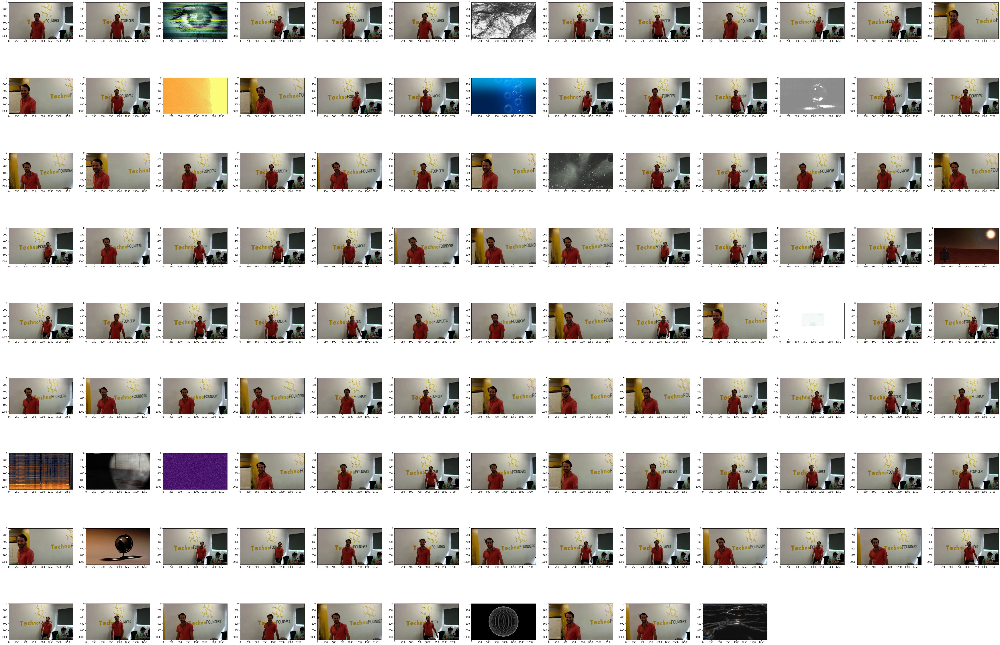

In [19]:
display_frames(frame_images)

We can see the order the vedio frames are shuffled and also presence of some noise frames as well. 

##### Computing the similarity metrics of each frames with respect to a reference frame, ideally by passing a frame which would be the inital frame of the reconstructed vedio. The frame similarity computation and sorting can be done by OpenCV Metrics and Scipy Metrics. 

#### OPENCV_METHOD_CHOICES
      
                cv2.HISTCMP_CORREL - Computes Correlation
                cv2.HISTCMP_CHISQR - Computes Chi-Squared
                cv2.HISTCMP_INTERSECT - Computes Intersection
                cv2.HISTCMP_BHATTACHARYYA - Hellinger

In [20]:
distance_metrics = video.frame_sorting_opencv(histogram_directory, reference_image= 'frame79.jpg',metric_choice= cv2.HISTCMP_CORREL)

 For similarity functions a LARGER value indicates higher similarity (Correlation and Intersection). And for others, a SMALLER value indicates higher similarity (Chi-Squared and Hellinger).Thus here we need to reverse the metrics to get the correlated images to the starting of frame list. 

In [21]:
distance_metrics.reverse()

In [22]:
distance_metrics

[(1.0, 'frame79.jpg'),
 (0.9999710890126918, 'frame1.jpg'),
 (0.9999059199929792, 'frame23.jpg'),
 (0.999821561558196, 'frame30.jpg'),
 (0.9997806877965979, 'frame93.jpg'),
 (0.9996682579751374, 'frame4.jpg'),
 (0.9995563612350444, 'frame66.jpg'),
 (0.9995203739617222, 'frame51.jpg'),
 (0.9992676991232335, 'frame52.jpg'),
 (0.9990824323425176, 'frame20.jpg'),
 (0.9990788715100601, 'frame54.jpg'),
 (0.9990360035664384, 'frame72.jpg'),
 (0.998796706853532, 'frame49.jpg'),
 (0.9987549045868395, 'frame59.jpg'),
 (0.9985895175704141, 'frame22.jpg'),
 (0.9980814822771965, 'frame32.jpg'),
 (0.9976945871292187, 'frame106.jpg'),
 (0.9975829047061481, 'frame64.jpg'),
 (0.9975348326128385, 'frame9.jpg'),
 (0.9972310587721154, 'frame104.jpg'),
 (0.9969274819852747, 'frame18.jpg'),
 (0.9968874197919582, 'frame15.jpg'),
 (0.9962586359036529, 'frame35.jpg'),
 (0.9961493041534434, 'frame61.jpg'),
 (0.9958466258268706, 'frame108.jpg'),
 (0.995611515386805, 'frame62.jpg'),
 (0.9954090451984438, 'frame3.

#### Fetching the sorted list of array images of the frames based on the distance metrics computed, and visualizing the sorted frames. 

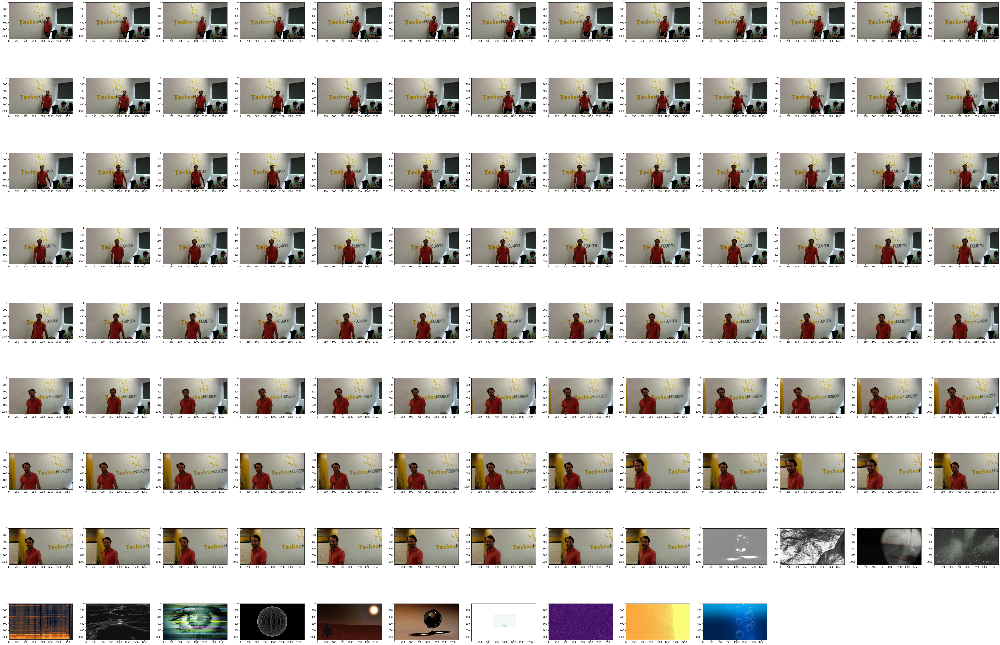

In [25]:
sorted_frames = get_sorted_frames(frame_directory, distance_metrics)
display_frames(sorted_frames)

Here we can see the frames are sorted and we can see a cohesion between each frames and the noise frames, which are outliers from main content are pushed to the end of the list. 

#### Method which eliminates the outlier based on the threshold hash difference value.

In [27]:
clean_frames = eliminate_outlier_frame(frame_directory, distance_metrics, hash_threshold = 20)

#### Visualizing the list of frames before reconstructing the vedio. 

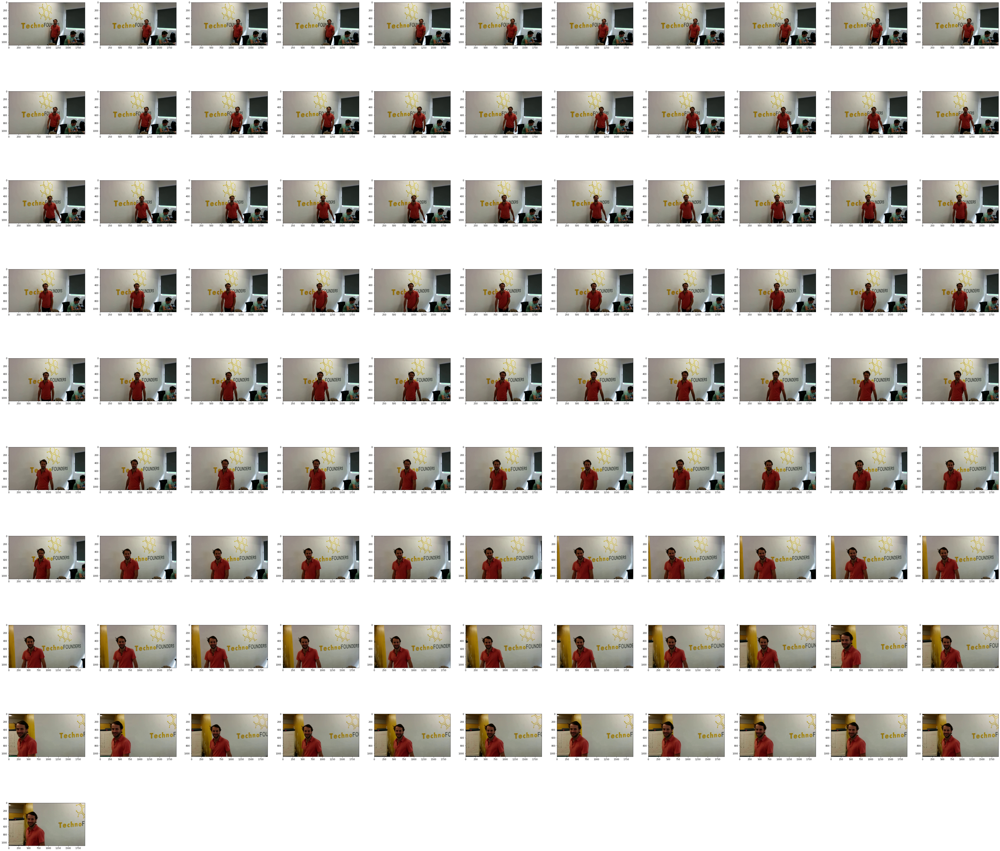

In [28]:
display_frames(clean_frames)

The method which saves the vedio from the final noise free and sorted list of frames. 

In [29]:
video.get_video_from_frames(clean_frames,'Reconstructed_Vedio.mp4')

OpenCV: FFMPEG: tag 0x58564944/'DIVX' is not supported with codec id 12 and format 'mp4 / MP4 (MPEG-4 Part 14)'
OpenCV: FFMPEG: fallback to use tag 0x7634706d/'mp4v'


Video Saved Successfully..!


The Vedio will saved to the same notebooks directory. 

The Current approach is based on grouping frames based on image similarity score. 

We can play around with OpenCV (Pixel Comparison approach) and Scipy (Image vector distance) methods to have better reconstructions depnding on the image features in different vedios. 

Furthur the two ressearch paper found interesting, testing those would be also considered for furthur imporvements. 

1. Video Reconstruction from Randomized Video Frames
https://web.stanford.edu/class/ee368/Project_Autumn_1617/Reports/report_danyliw.pdf


2. Time Ordering Shuffling for Improving Background Subtraction
http://www.telecom.ulg.ac.be/publi/publications/laugraud/Laugraud2015Time/#biblio-2